# 1. Problem Statement

# 2. Getting Started - Loading Libraries and Datasets

## 2.1 Load Libraries

In [1]:
# import libraries needed
import pandas as pd
import numpy as np
import json
import seaborn as sns
import matplotlib.pyplot as plt
import ast # convert dictionary-look list into dictionary
import re # extract the hashtags
from collections import Counter # count the number of hashtags showing as lists in a column
from datetime import datetime
from sklearn.feature_extraction.text import CountVectorizer
from textblob import TextBlob # TextBlob - for sentiment analysis
import concurrent.futures # use in sentiment analysis - for efficient analysis
import nltk # for sentiment analysis 
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer # sentiment analysis, working together with nltk
from nltk.tokenize import word_tokenize # when looking for common words used in the 'negative' comments
from nltk.corpus import stopwords # remove stop words
import string # use when removing punctuations

## 2.2 Load TikTok Datasets

In [88]:
# read in the 'comments' data from a JSON file
with open('comments.json') as f:
    comment = json.load(f)

In [89]:
# iterate through the file, print some parts to verify the readness of the dataset
for i in comment['https://www.tiktok.com/@kimisshe/video/7208767339234364714']:
    print(i)

{'user_id': 'drewpilot001', 'text': 'yummy 😁', 'like_count': '0', 'user_name': 'Adrewthepilot'}
{'user_id': 'kimisshe', 'text': "Community discussion....what's your healthy snack idea? Butternut squash is my latest veggie addition.", 'like_count': '0', 'user_name': 'KimIsShe'}


In [4]:
type(comment)

dict

In [2]:
# read in the 'url' text file
with open('Urls_Scrape2 (1).txt') as f:
    url = f.read()

# transform the text format to JSON format
url =  json.loads(url)

In [6]:
url

{'https://www.tiktok.com/@quefourfour/video/7071999725515427114': {'users': [{'user_id': 'quefourfour',
    'user_name': 'quefourfour',
    'is_verifed': False}],
  'text': {'desc': 'Beef brisket #manshallnotlivebybreadalone #quefourfour #simplythebest #keto',
   'challenges': ['manshallnotlivebybreadalone',
    'quefourfour',
    'simplythebest',
    'keto'],
   'tagged': []},
  'music': {'title': 'original sound', 'author_name': 'quefourfour'},
  'video': {'id': '7071999725515427114',
   'ratio': '720p',
   'height': 1024,
   'width': 576,
   'createTime': '1646578249',
   'duration': 31,
   'bitrate': 1696223,
   'encodedType': 'normal',
   'format': 'mp4',
   'videoQuality': 'normal',
   'codecType': 'h264',
   'definition': '720p'},
  'stats': {'diggCount': 124100,
   'shareCount': 2328,
   'commentCount': 1461,
   'playCount': 3200000}},
 'https://www.tiktok.com/@christinephilippa/video/7127245635572583681': {'users': [{'user_id': 'christinephilippa',
    'user_name': 'Christine 

In [3]:
# verify the read
for i in url['https://www.tiktok.com/@quefourfour/video/7071999725515427114']:
    print(i)

users
text
music
video
stats


In [8]:
## try with a parse of the whole url file - 'new' txt file
with open('new.txt') as f2:
    new = f2.read()
    print(new)

a = json.loads(new)

for i in a['https://www.tiktok.com/@quefourfour/video/7071999725515427114']:
    print(i)

{    "https://www.tiktok.com/@quefourfour/video/7071999725515427114": {
        "users": [{
            "user_id": "quefourfour", 
            "user_name": "quefourfour", 
            "is_verifed": false
        }], 
        "text": {
            "desc": "Beef brisket #manshallnotlivebybreadalone #quefourfour #simplythebest #keto", 
            "challenges": ["manshallnotlivebybreadalone", "quefourfour", "simplythebest", "keto"], 
            "tagged": []
            }, 
        "music": {
            "title": "original sound", 
            "author_name": "quefourfour"
        }, 
        "video": {
            "id": "7071999725515427114", 
            "ratio": "720p", 
            "height": 1024, 
            "width": 576, 
            "createTime": "1646578249", 
            "duration": 31, 
            "bitrate": 1696223, 
            "encodedType": "normal", 
            "format": "mp4", 
            "videoQuality": "normal", 
            "codecType": "h264", 
            "definiti

In [4]:
url = pd.DataFrame.from_dict(url, orient = 'columns').T
url.head()

,users,text,music,video,stats
https://www.tiktok.com/@quefourfour/video/7071999725515427114,"[{'user_id': 'quefourfour', 'user_name': 'quef...",{'desc': 'Beef brisket #manshallnotlivebybread...,"{'title': 'original sound', 'author_name': 'qu...","{'id': '7071999725515427114', 'ratio': '720p',...","{'diggCount': 124100, 'shareCount': 2328, 'com..."
https://www.tiktok.com/@christinephilippa/video/7127245635572583681,"[{'user_id': 'christinephilippa', 'user_name':...",{'desc': 'Replying to @ellen_sarah1 inside wi...,"{'title': 'original sound', 'author_name': 'li...","{'id': '7127245635572583681', 'ratio': '720p',...","{'diggCount': 6650, 'shareCount': 4, 'commentC..."
https://www.tiktok.com/@missdeedang/video/6890445281410731265,"[{'user_id': 'missdeedang', 'user_name': 'Dee ...",{'desc': 'Pwede ba ang Saging sa Keto-Low Carb...,"{'title': 'original sound - Dee ♥️', 'author_n...","{'id': '6890445281410731265', 'ratio': '720p',...","{'diggCount': 23600, 'shareCount': 21, 'commen..."
https://www.tiktok.com/@tinydancingsocialworker/video/6903730689737362693,"[{'user_id': 'tinydancingsocialworker', 'user_...",{'desc': '#stitch with @livs_journey7 #greensc...,"{'title': 'original sound', 'author_name': 'Em...","{'id': '6903730689737362693', 'ratio': '720p',...","{'diggCount': 11, 'shareCount': 0, 'commentCou..."
https://www.tiktok.com/@howwelife247/video/6845669009946348805,"[{'user_id': 'howwelife247', 'user_name': 'How...",{'desc': '#protein #momsoftiktok #dadsoftiktok...,"{'title': 'original sound', 'author_name': 'Ho...","{'id': '6845669009946348805', 'ratio': '720p',...","{'diggCount': 16800, 'shareCount': 1538, 'comm..."


In [5]:
# convert the dict_look list into list (the 'user' column)
def lst_to_dict(lst):
    return lst[0]

url['users'] = url['users'].apply(lambda lst: lst_to_dict (lst))

In [6]:
url['video'][0]

{'id': '7071999725515427114',
 'ratio': '720p',
 'height': 1024,
 'width': 576,
 'createTime': '1646578249',
 'duration': 31,
 'bitrate': 1696223,
 'encodedType': 'normal',
 'format': 'mp4',
 'videoQuality': 'normal',
 'codecType': 'h264',
 'definition': '720p'}

In [7]:
# extract keys from the dictionaries to new columns
url['user_id'] = url['users'].apply(lambda x: x['user_id'])
url['user_name'] = url['users'].apply(lambda x: x['user_name'])
url['is_verified'] = url['users'].apply(lambda x: x['is_verifed'])

url['desc'] = url['text'].apply(lambda x: x['desc'])
url['challenges'] = url['text'].apply(lambda x: x['challenges'])
url['tagged'] = url['text'].apply(lambda x: x['tagged'])

url['m_title'] = url['music'].apply(lambda x: x['title'])
url['m_author'] = url['music'].apply(lambda x: x['author_name'])

url['video_id'] = url['video'].apply(lambda x: x['id'])
url['video_ratio'] = url['video'].apply(lambda x: x['ratio'])
url['video_height'] = url['video'].apply(lambda x: x['height'])
url['video_width'] = url['video'].apply(lambda x: x['width'])
url['video_create_time'] = url['video'].apply(lambda x: x['createTime'])
url['video_duration'] = url['video'].apply(lambda x: x['duration'])
url['video_bitrate'] = url['video'].apply(lambda x: x['bitrate'])
url['video_encodedtype'] = url['video'].apply(lambda x: x['encodedType'])
url['video_format'] = url['video'].apply(lambda x: x['format'])
url['video_quality'] = url['video'].apply(lambda x: x['videoQuality'])
url['video_codectype'] = url['video'].apply(lambda x: x['codecType'])
url['video_definition'] = url['video'].apply(lambda x: x['definition'])

url['diggcount'] = url['stats'].apply(lambda x: x['diggCount'])
url['sharecount'] = url['stats'].apply(lambda x: x['shareCount'])
url['commentcount'] = url['stats'].apply(lambda x: x['commentCount'])
url['playcount'] = url['stats'].apply(lambda x: x['playCount'])

In [8]:
url.drop(columns=['users','text','music','video','stats'], inplace = True)

In [23]:
url

,user_id,user_name,is_verified,desc,challenges,tagged,m_title,m_author,video_id,video_ratio,...,video_bitrate,video_encodedtype,video_format,video_quality,video_codectype,video_definition,diggcount,sharecount,commentcount,playcount
https://www.tiktok.com/@quefourfour/video/7071999725515427114,quefourfour,quefourfour,False,Beef brisket #manshallnotlivebybreadalone #que...,"[manshallnotlivebybreadalone, quefourfour, sim...",[],original sound,quefourfour,7071999725515427114,720p,...,1696223.0,normal,mp4,normal,h264,720p,124100,2328,1461,3200000
https://www.tiktok.com/@christinephilippa/video/7127245635572583681,christinephilippa,Christine | Mother + Self Love,False,Replying to @ellen_sarah1 inside with my kidd...,"[bodygoals, postpartum, momlife, heslthjourney...",[ellen_sarah1],original sound,lillie™,7127245635572583681,720p,...,1108580.0,normal,mp4,normal,h264,720p,6650,4,19,96600
https://www.tiktok.com/@missdeedang/video/6890445281410731265,missdeedang,Dee ♥️,False,Pwede ba ang Saging sa Keto-Low Carb Diet? #ke...,"[keto, lowcarb, LearnOnTikTok, diet, saging, i...",[],original sound - Dee ♥️,Dee ♥️,6890445281410731265,720p,...,1394839.0,normal,mp4,normal,h264,720p,23600,21,19,208700
https://www.tiktok.com/@tinydancingsocialworker/video/6903730689737362693,tinydancingsocialworker,"Emily Marie, MSW",False,#stitch with @livs_journey7 #greenscreen #edve...,"[fearfoodchallenge, edvent, greenscreen, edven...",[livs_journey7],original sound,"Emily Marie, MSW",6903730689737362693,720p,...,387700.0,normal,mp4,normal,h264,720p,11,0,3,286
https://www.tiktok.com/@howwelife247/video/6845669009946348805,howwelife247,Howwelife247,False,#protein #momsoftiktok #dadsoftiktok #easyreci...,"[carbsdontmakeyoufat, protein, MomsofTikTok, d...",[],original sound,Howwelife247,6845669009946348805,720p,...,1192432.0,normal,mp4,normal,h264,720p,16800,1538,136,238400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
https://www.tiktok.com/@khroniclesofkat/video/7209489310842719531,khroniclesofkat,kat,False,one thing about me is im a drink girly💅🏻 i wil...,"[intuitiveeating, realfoodingredients, cleanin...",[],original sound,user09283254511,7209489310842719531,,...,NaN,None,None,None,None,None,15400,125,112,132100
https://www.tiktok.com/@meet_desiree/video/7001686373791042821,meet_desiree,Desiree,False,#greenscreen #proudmom #proudmoment #bodyposit...,"[greenscreen, proudmom, proudmoment, bodyposit...",[],original sound,Desiree,7001686373791042821,720p,...,1335991.0,normal,mp4,normal,h264,720p,2700000,7005,13000,8800000
https://www.tiktok.com/@gabbykisor/video/6831633739198631174,gabbykisor,Gabby Kisor,False,The TikTok algorithm really been stopping my w...,"[rainonme, weightloss, transformation, weightl...",[],weight loss check,elizabeth the first,6831633739198631174,720p,...,1123664.0,normal,mp4,normal,h264,720p,1000000,5300,5161,5400000
https://www.tiktok.com/@vanessanoemayorquinn/video/7078928016499363114,vanessanoemayorquinn,Vanessanoe✨,False,"Low Carb, High Protein salad🔥 #macrofriendlyre...","[healthymeal, macrofriendlyrecipe, healthydinn...",[],Tom's Diner,AnnenMayKantereit & Giant Rooks,7078928016499363114,720p,...,2230828.0,normal,mp4,normal,h264,720p,10200,374,39,170200


In [9]:
url.shape

(14816, 24)

In [14]:
url.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14816 entries, https://www.tiktok.com/@quefourfour/video/7071999725515427114 to https://www.tiktok.com/@tiffsrec/video/6865030912879414533
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   user_id            14816 non-null  object 
 1   user_name          14816 non-null  object 
 2   is_verified        14816 non-null  bool   
 3   desc               14816 non-null  object 
 4   challenges         14816 non-null  object 
 5   tagged             14816 non-null  object 
 6   m_title            14816 non-null  object 
 7   m_author           14673 non-null  object 
 8   video_id           14816 non-null  object 
 9   video_ratio        14816 non-null  object 
 10  video_height       14816 non-null  int64  
 11  video_width        14816 non-null  int64  
 12  video_create_time  14816 non-null  object 
 13  video_duration     14816 non-null  int64  
 14  video_bitr

In [24]:
url_descirbe = url.describe()
url_descirbe

,video_height,video_width,video_duration,video_bitrate,diggcount,sharecount,commentcount,playcount
count,14816.000000,14816.000000,14816.000000,1.459400e+04,1.481600e+04,14816.000000,14816.000000,1.481600e+04
mean,995.972327,572.090983,33.933855,1.287822e+06,2.332820e+05,4422.450459,1847.962878,1.896931e+06
std,149.381707,90.963982,36.582280,5.766849e+05,5.416404e+05,19603.198397,6295.813895,4.513924e+06
min,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00
25%,1024.000000,576.000000,11.000000,9.222692e+05,5.098000e+03,22.000000,41.000000,5.165000e+04
50%,1024.000000,576.000000,21.000000,1.233897e+06,3.010000e+04,232.000000,247.000000,3.583500e+05
75%,1024.000000,576.000000,48.000000,1.583703e+06,2.057000e+05,1751.500000,1095.000000,1.800000e+06
max,1920.000000,1280.000000,489.000000,6.136039e+06,9.400000e+06,877800.000000,194300.000000,1.088000e+08


In [16]:
url.columns

Index(['user_id', 'user_name', 'is_verified', 'desc', 'challenges', 'tagged',
       'm_title', 'm_author', 'video_id', 'video_ratio', 'video_height',
       'video_width', 'video_create_time', 'video_duration', 'video_bitrate',
       'video_encodedtype', 'video_format', 'video_quality', 'video_codectype',
       'video_definition', 'diggcount', 'sharecount', 'commentcount',
       'playcount'],
      dtype='object')

# EDA: Urls_Scrape2 (1) dataset

In [17]:
url.head()

,user_id,user_name,is_verified,desc,challenges,tagged,m_title,m_author,video_id,video_ratio,...,video_bitrate,video_encodedtype,video_format,video_quality,video_codectype,video_definition,diggcount,sharecount,commentcount,playcount
https://www.tiktok.com/@quefourfour/video/7071999725515427114,quefourfour,quefourfour,False,Beef brisket #manshallnotlivebybreadalone #que...,"[manshallnotlivebybreadalone, quefourfour, sim...",[],original sound,quefourfour,7071999725515427114,720p,...,1696223.0,normal,mp4,normal,h264,720p,124100,2328,1461,3200000
https://www.tiktok.com/@christinephilippa/video/7127245635572583681,christinephilippa,Christine | Mother + Self Love,False,Replying to @ellen_sarah1 inside with my kidd...,"[bodygoals, postpartum, momlife, heslthjourney...",[ellen_sarah1],original sound,lillie™,7127245635572583681,720p,...,1108580.0,normal,mp4,normal,h264,720p,6650,4,19,96600
https://www.tiktok.com/@missdeedang/video/6890445281410731265,missdeedang,Dee ♥️,False,Pwede ba ang Saging sa Keto-Low Carb Diet? #ke...,"[keto, lowcarb, LearnOnTikTok, diet, saging, i...",[],original sound - Dee ♥️,Dee ♥️,6890445281410731265,720p,...,1394839.0,normal,mp4,normal,h264,720p,23600,21,19,208700
https://www.tiktok.com/@tinydancingsocialworker/video/6903730689737362693,tinydancingsocialworker,"Emily Marie, MSW",False,#stitch with @livs_journey7 #greenscreen #edve...,"[fearfoodchallenge, edvent, greenscreen, edven...",[livs_journey7],original sound,"Emily Marie, MSW",6903730689737362693,720p,...,387700.0,normal,mp4,normal,h264,720p,11,0,3,286
https://www.tiktok.com/@howwelife247/video/6845669009946348805,howwelife247,Howwelife247,False,#protein #momsoftiktok #dadsoftiktok #easyreci...,"[carbsdontmakeyoufat, protein, MomsofTikTok, d...",[],original sound,Howwelife247,6845669009946348805,720p,...,1192432.0,normal,mp4,normal,h264,720p,16800,1538,136,238400


<Axes: >

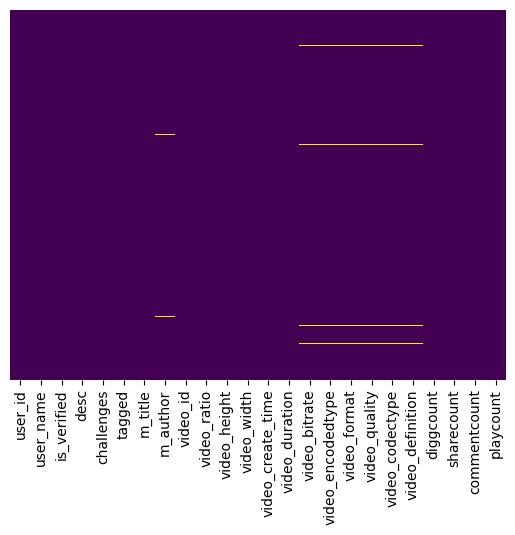

In [18]:
# check the missing data
sns.heatmap(url.isnull(),yticklabels=False,cbar=False,cmap='viridis')

<Axes: xlabel='is_verified', ylabel='count'>

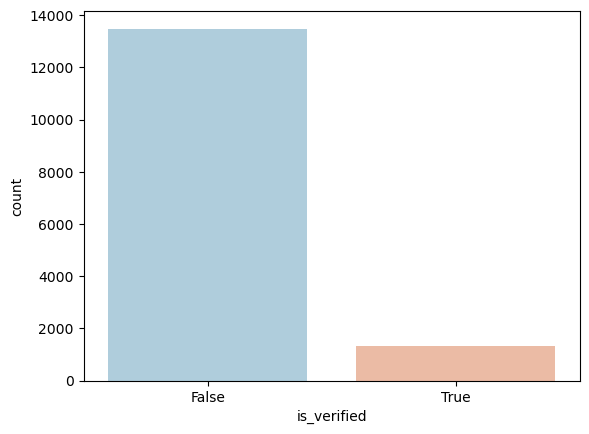

In [19]:
sns.countplot(x='is_verified',data=url,palette='RdBu_r')
# most of the video posters are unverified

In [38]:
# extract (hashtags) keywords from 'desc' column
url['hashtag'] = url['desc'].apply(lambda x: re.findall(r'#(\w+)',x))

# flatten the lists of hashtags into a single list
all_hashtags = [tag for tags in url['hashtag'] for tag in tags]

# count the occurrences of each hashtag
hashtag_counts = Counter(all_hashtags)

# Convert the Counter object to a DataFrame for better presentation
df_hashtag_counts = pd.DataFrame(list(hashtag_counts.items()), columns=['hashtag', 'count'])

# Sort the DataFrame by Count in descending order
df_hashtag_counts = df_hashtag_counts.sort_values(by='count', ascending=False)

# show the most frequent ones
df_hashtag_counts

,hashtag,count
33,fyp,4645
91,foryou,2045
49,weightloss,1952
44,bodypositivity,1868
3,keto,1479
...,...,...
12199,musicaltheatre,1
12200,selfconscious,1
12202,2020Wrapped,1
12205,blackpeopleketo,1


In [39]:
frequent_hashtag = df_hashtag_counts.head(20)
frequent_hashtag

,hashtag,count
33,fyp,4645
91,foryou,2045
49,weightloss,1952
44,bodypositivity,1868
3,keto,1479
34,whatieatinaday,1395
21,edrecovery,1221
95,foryoupage,1118
81,fypシ,996
247,juicecleanse,975


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 [Text(0, 0, 'fyp'),
  Text(1, 0, 'foryou'),
  Text(2, 0, 'weightloss'),
  Text(3, 0, 'bodypositivity'),
  Text(4, 0, 'keto'),
  Text(5, 0, 'whatieatinaday'),
  Text(6, 0, 'edrecovery'),
  Text(7, 0, 'foryoupage'),
  Text(8, 0, 'fypシ'),
  Text(9, 0, 'juicecleanse'),
  Text(10, 0, 'bodyimage'),
  Text(11, 0, 'intermittentfasting'),
  Text(12, 0, 'dietculture'),
  Text(13, 0, 'fearfood'),
  Text(14, 0, 'fatacceptance'),
  Text(15, 0, 'cleaneating'),
  Text(16, 0, 'bodygoals'),
  Text(17, 0, 'food'),
  Text(18, 0, 'fitness'),
  Text(19, 0, 'recovery')])

/Users/sunweilu/anaconda3/envs/ds/lib/python3.11/site-packages/IPython/core/events.py:93: UserWarning: Glyph 12471 (\N{KATAKANA LETTER SI}) missing from current font.
  func(*args, **kwargs)
/Users/sunweilu/anaconda3/envs/ds/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12471 (\N{KATAKANA LETTER SI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


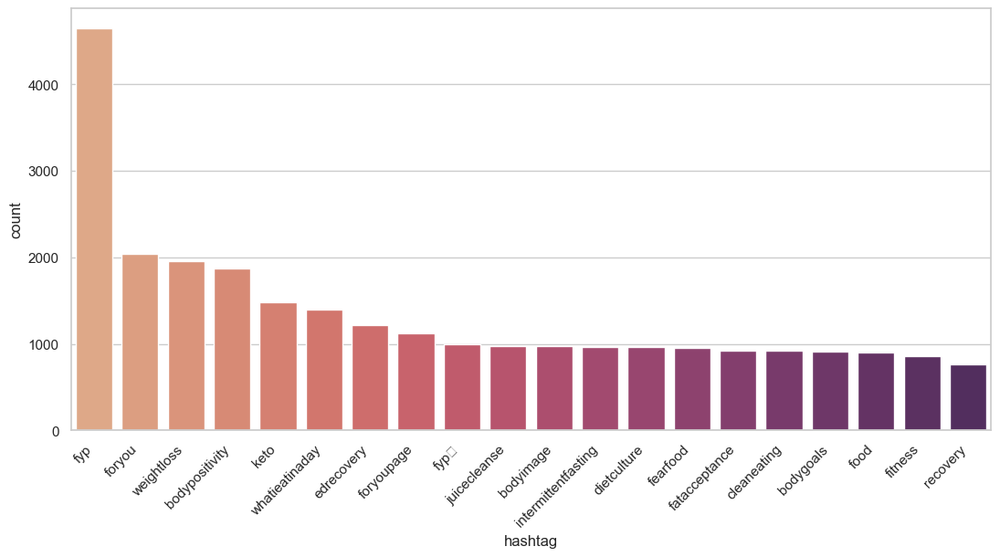

In [44]:
# most frequent 20 hashtags
plt.figure(figsize=(13, 6))
sns.barplot(data=frequent_hashtag, x='hashtag',y='count',palette='flare')
plt.xticks(rotation=45, ha='right')

/var/folders/rp/81kw9f457w1chzvpxczhd9jh0000gn/T/ipykernel_1817/217634271.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_hashtag_counts['count'],color='skyblue')


<Axes: xlabel='count', ylabel='Density'>

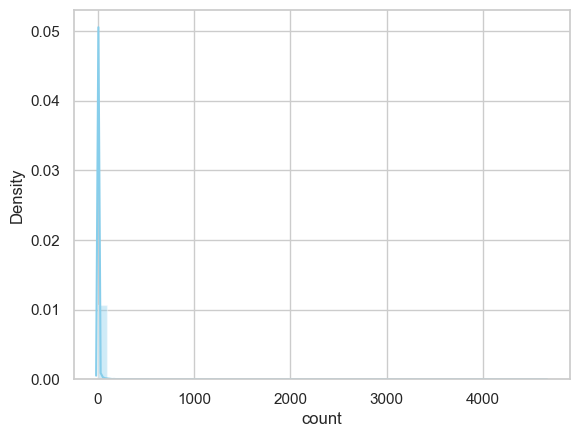

In [51]:
sns.distplot(df_hashtag_counts['count'],color='skyblue')

In [23]:
a = df_hashtag_counts.loc[df_hashtag_counts['count']<2000]
a

,hashtag,count
49,weightloss,1952
44,bodypositivity,1868
3,keto,1479
34,whatieatinaday,1395
21,edrecovery,1221
...,...,...
12199,musicaltheatre,1
12200,selfconscious,1
12202,2020Wrapped,1
12205,blackpeopleketo,1


/var/folders/rp/81kw9f457w1chzvpxczhd9jh0000gn/T/ipykernel_1362/598466426.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(a['count'], color='skyblue')


<Axes: xlabel='count', ylabel='Density'>

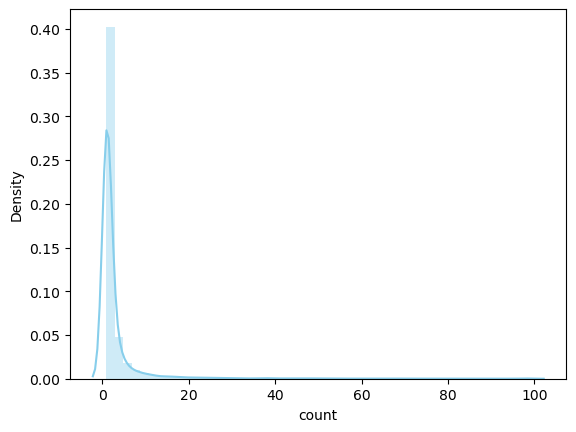

In [24]:
a = df_hashtag_counts.loc[df_hashtag_counts['count']<100]
sns.distplot(a['count'], color='skyblue')
# most hashtags only occur once, despite a few hashtags appear many times, most hasgtags only show under 20 times

<Axes: xlabel='challenge', ylabel='count'>

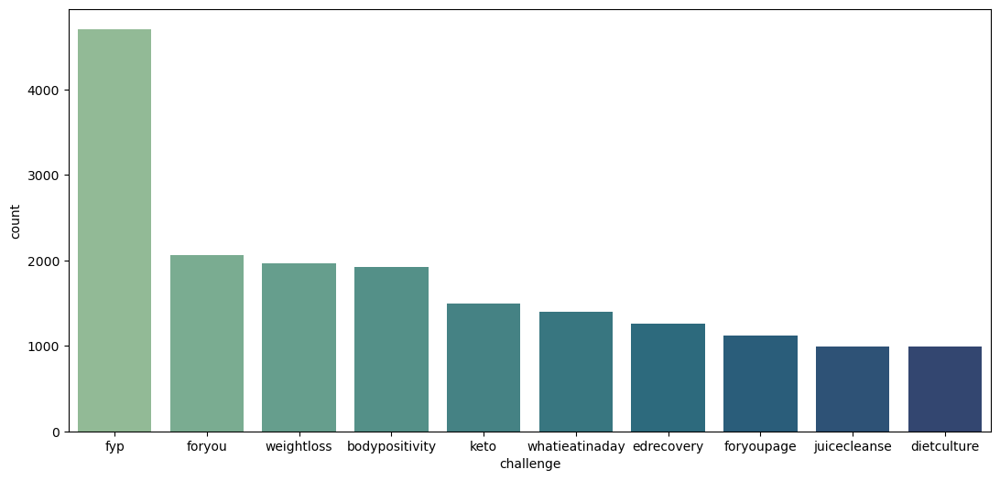

In [25]:
# extract the 'challenge' keywords from lists in the column
# flatten the lists of challenges into a single list
all_challenges = [chall for challs in url['challenges'] for chall in challs]

# count the occurrences of each challenge
chall_counts = Counter(all_challenges)

# Convert the Counter object to a DataFrame for better presentation
df_chall_counts = pd.DataFrame(list(chall_counts.items()), columns=['challenge', 'count'])

# Sort the DataFrame by Count in descending order
df_chall_counts = df_chall_counts.sort_values(by='count', ascending=False)

# show the most frequent ones
df_chall_counts

# most hot 10 challenges
df_chall_counts_fre = df_chall_counts.head(10)
plt.figure(figsize=(13, 6))
sns.barplot(data=df_chall_counts_fre, x='challenge',y='count',palette='crest')

In [26]:
type(url['video_create_time'][0])

str

In [78]:
# convert the datetime column to 'date' type
def convert_time(timestamp_str):
    return datetime.utcfromtimestamp(int(timestamp_str))

url['video_create_time'] = url['video_create_time'].apply(lambda x: convert_time(x))

In [28]:
url.loc[(url['video_create_time'] > '2022') & (url['video_create_time'] < '2023')].shape

(5857, 25)

In [29]:
url.loc[(url['video_create_time'] > '2021') & (url['video_create_time'] < '2022')].shape

(4363, 25)

In [30]:
url.loc[(url['video_create_time'] > '2020') & (url['video_create_time'] < '2021')].shape

(2332, 25)

In [31]:
url.loc[(url['video_create_time'] > '2019') & (url['video_create_time'] < '2020')].shape

(104, 25)

In [32]:
url.loc[(url['video_create_time'] < '2019')].shape

(8, 25)

In [33]:
url['video_create_time'].min()

Timestamp('2016-12-30 03:30:10')

In [34]:
url['video_create_time'].max()

Timestamp('2023-04-20 03:57:06')

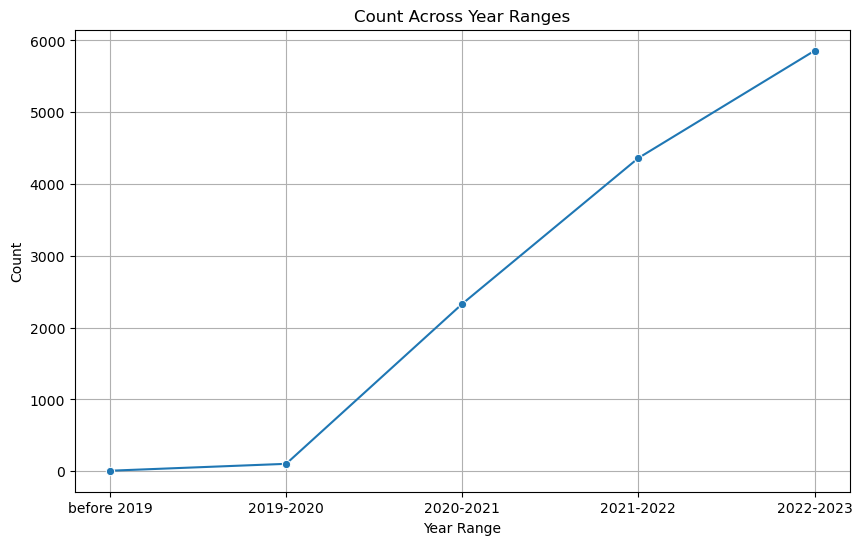

In [35]:
# draw a line plot to show the count across time
# 这个图没有下面一个distribution的图来得直观
count_time = pd.DataFrame({'before 2019': [8], '2019-2020': [104], '2020-2021': [2332], '2021-2022': [4363], '2022-2023': [5857]})
count_time_melted = count_time.melt(var_name='Year Range', value_name='Count')

plt.figure(figsize=(10, 6))
sns.lineplot(x='Year Range', y='Count', data=count_time_melted, marker='o')
plt.title('Count Across Year Ranges')
plt.xlabel('Year Range')
plt.ylabel('Count')
plt.grid(True)
plt.show()

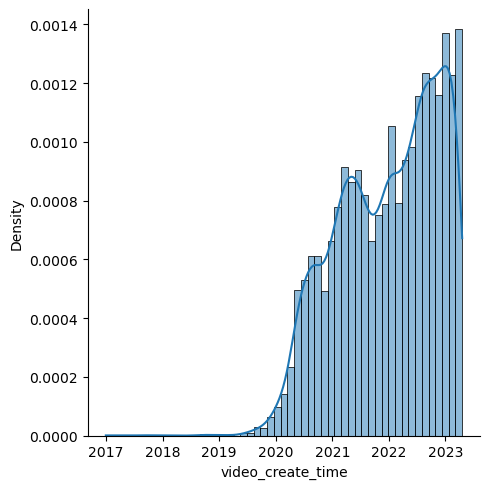

In [36]:
# the distribution of video_create_time
sns.displot(url['video_create_time'], kde=True, stat='density')

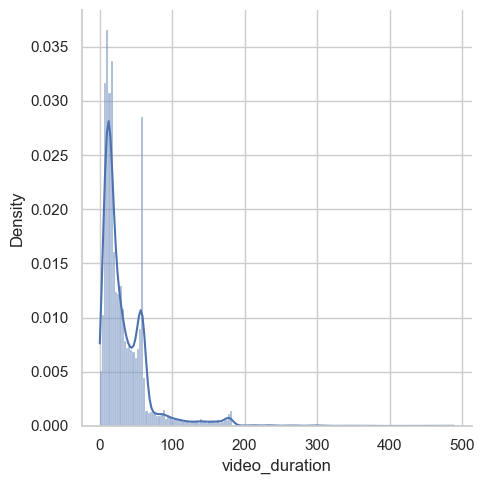

In [52]:
# see the distribution of video duration
sns.displot(url['video_duration'], kde=True, stat='density')

In [38]:
url.columns

Index(['user_id', 'user_name', 'is_verified', 'desc', 'challenges', 'tagged',
       'm_title', 'm_author', 'video_id', 'video_ratio', 'video_height',
       'video_width', 'video_create_time', 'video_duration', 'video_bitrate',
       'video_encodedtype', 'video_format', 'video_quality', 'video_codectype',
       'video_definition', 'diggcount', 'sharecount', 'commentcount',
       'playcount', 'hashtag'],
      dtype='object')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
 [Text(0, 0, 'weightloss'),
  Text(1, 0, 'fyp'),
  Text(2, 0, 'bodypositivity'),
  Text(3, 0, 'foryou'),
  Text(4, 0, 'foryoupage'),
  Text(5, 0, 'whatieatinaday'),
  Text(6, 0, 'fitness'),
  Text(7, 0, 'transformation'),
  Text(8, 0, 'viral'),
  Text(9, 0, 'bodyimage'),
  Text(10, 0, 'fypシ'),
  Text(11, 0, 'motivation'),
  Text(12, 0, 'selflove'),
  Text(13, 0, 'weightlosstransformation'),
  Text(14, 0, 'weightlossjourney')])

/Users/sunweilu/anaconda3/envs/ds/lib/python3.11/site-packages/IPython/core/events.py:93: UserWarning: Glyph 12471 (\N{KATAKANA LETTER SI}) missing from current font.
  func(*args, **kwargs)
/Users/sunweilu/anaconda3/envs/ds/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12471 (\N{KATAKANA LETTER SI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


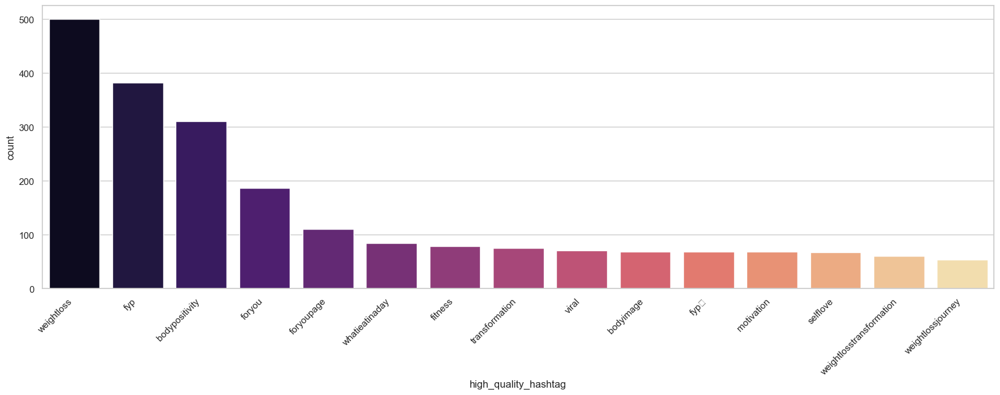

In [53]:
# top-quality videos based on 'commentcount', 'diggcount', and 'sharecount'
url['quality'] = url['diggcount'] * 1/3 + url['commentcount'] * 1/3 + url['sharecount'] * 1/3
url_high_quality = url.sort_values(by='quality', ascending=False).head(1000)
url_high_quality

# look for the common points in these 'high-quality' videos
# common hasgtags
url_high_quality['hashtag']

# flatten the lists of hashtags into a single list
quality_hashtags = [tag for tags in url_high_quality['hashtag'] for tag in tags]

# count the occurrences of each hashtag
quality_hashtag_counts = Counter(quality_hashtags)

# Convert the Counter object to a DataFrame for better presentation
df_quality_hashtag_counts = pd.DataFrame(list(quality_hashtag_counts.items()), columns=['high_quality_hashtag', 'count'])

# Sort the DataFrame by Count in descending order
df_quality_hashtag_counts = df_quality_hashtag_counts.sort_values(by='count', ascending=False).head(15)

# show the most frequent ones
df_quality_hashtag_counts

# plot the results
plt.figure(figsize=(20, 6))
sns.barplot(data=df_quality_hashtag_counts, x='high_quality_hashtag',y='count',palette='magma')
plt.xticks(rotation=45, ha='right')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
 [Text(0, 0, 'weightloss'),
  Text(1, 0, 'fyp'),
  Text(2, 0, 'bodypositivity'),
  Text(3, 0, 'foryou'),
  Text(4, 0, 'foryoupage'),
  Text(5, 0, 'whatieatinaday'),
  Text(6, 0, 'fitness'),
  Text(7, 0, 'viral'),
  Text(8, 0, 'keto'),
  Text(9, 0, 'transformation'),
  Text(10, 0, 'motivation'),
  Text(11, 0, 'fypシ'),
  Text(12, 0, 'weightlosstransformation'),
  Text(13, 0, 'selflove'),
  Text(14, 0, 'food')])

/Users/sunweilu/anaconda3/envs/ds/lib/python3.11/site-packages/IPython/core/events.py:93: UserWarning: Glyph 12471 (\N{KATAKANA LETTER SI}) missing from current font.
  func(*args, **kwargs)
/Users/sunweilu/anaconda3/envs/ds/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12471 (\N{KATAKANA LETTER SI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


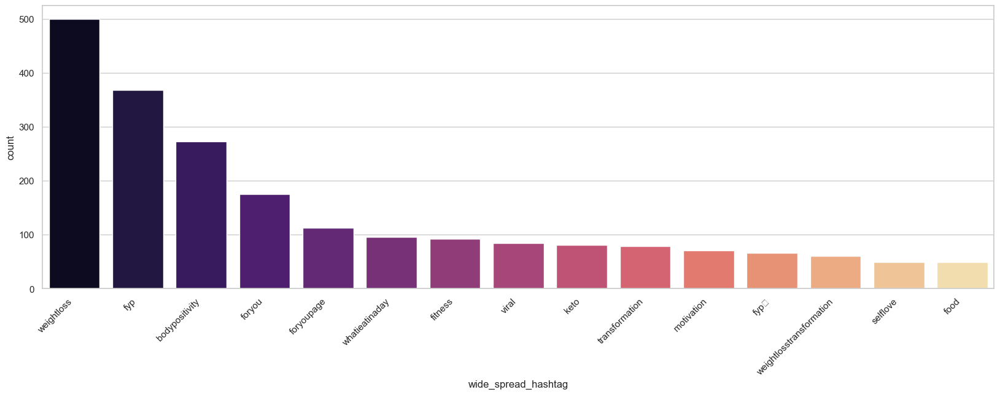

In [54]:
# most wide-spread videos based on 'playcount'
url_spread = url.sort_values(by='playcount', ascending=False).head(1000)
url_spread

# look for the common points in these 'wide-spread' videos
# common hasgtags
url_spread['hashtag']

# flatten the lists of hashtags into a single list
spread_hashtags = [tag for tags in url_spread['hashtag'] for tag in tags]

# count the occurrences of each hashtag
spread_hashtag_counts = Counter(spread_hashtags)

# Convert the Counter object to a DataFrame for better presentation
df_spread_hashtag_counts = pd.DataFrame(list(spread_hashtag_counts.items()), columns=['wide_spread_hashtag', 'count'])

# Sort the DataFrame by Count in descending order
df_spread_hashtag_counts = df_spread_hashtag_counts.sort_values(by='count', ascending=False).head(15)

# show the most frequent ones
df_spread_hashtag_counts

# plot the results
plt.figure(figsize=(20, 6))
sns.barplot(data=df_spread_hashtag_counts, x='wide_spread_hashtag',y='count',palette='magma')
plt.xticks(rotation=45, ha='right')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
 [Text(0, 0, 'weightloss'),
  Text(1, 0, 'fyp'),
  Text(2, 0, 'bodypositivity'),
  Text(3, 0, 'foryou'),
  Text(4, 0, 'foryoupage'),
  Text(5, 0, 'whatieatinaday'),
  Text(6, 0, 'fitness'),
  Text(7, 0, 'viral'),
  Text(8, 0, 'transformation'),
  Text(9, 0, 'keto'),
  Text(10, 0, 'motivation'),
  Text(11, 0, 'fypシ'),
  Text(12, 0, 'weightlosstransformation'),
  Text(13, 0, 'gym'),
  Text(14, 0, 'weightlosscheck')])

/Users/sunweilu/anaconda3/envs/ds/lib/python3.11/site-packages/IPython/core/events.py:93: UserWarning: Glyph 12471 (\N{KATAKANA LETTER SI}) missing from current font.
  func(*args, **kwargs)
/Users/sunweilu/anaconda3/envs/ds/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12471 (\N{KATAKANA LETTER SI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


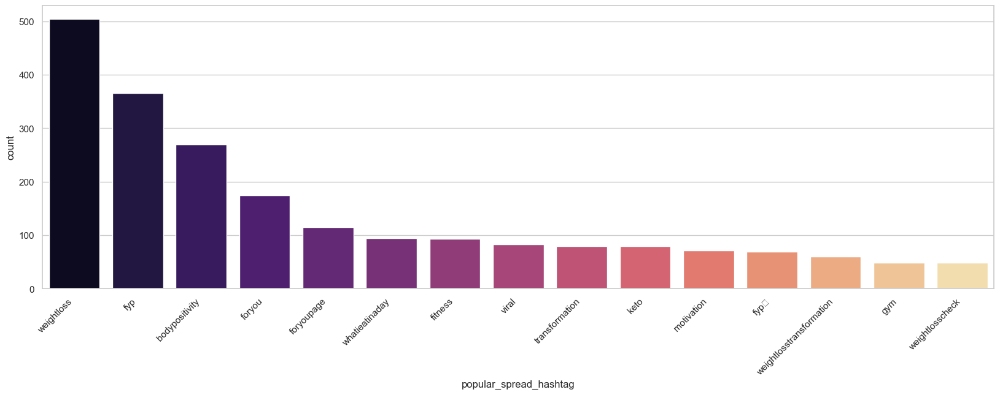

In [80]:
# combine the 'quality' and 'wide-spread' to see those 'popular' videos' commons

url['popularity'] = 1/2 * url['playcount'] + 1/2 * url['quality']

# most wide-spread videos based on 'playcount'
url_popular = url.sort_values(by='popularity', ascending=False).head(1000)
url_popular

# look for the common points in these 'popular' videos
# common hasgtags
url_popular['hashtag']

# flatten the lists of hashtags into a single list
popular_hashtags = [tag for tags in url_popular['hashtag'] for tag in tags]

# count the occurrences of each hashtag
popular_hashtag_counts = Counter(popular_hashtags)

# Convert the Counter object to a DataFrame for better presentation
df_popular_hashtag_counts = pd.DataFrame(list(popular_hashtag_counts.items()), columns=['popular_spread_hashtag', 'count'])

# Sort the DataFrame by Count in descending order
df_popular_hashtag_counts = df_popular_hashtag_counts.sort_values(by='count', ascending=False).head(15)

# show the most frequent ones
df_popular_hashtag_counts

# plot the results
plt.figure(figsize=(20, 6))
sns.barplot(data=df_popular_hashtag_counts, x='popular_spread_hashtag',y='count',palette='magma')
plt.xticks(rotation=45, ha='right')

In [58]:
# # find the most common 'words' in the description of these most popular videos
# url_popular['desc']

# # combine all text from the 'desc' column into a single string
# all_text = ' '.join(url_popular['desc'])

# # Use CountVectorizer to count the occurrences of each word
# vectorizer = CountVectorizer()
# word_counts = vectorizer.fit_transform([all_text])

# # Create a DataFrame with the word counts
# word_counts_df = pd.DataFrame(
#     data=word_counts.toarray()[0],
#     index=vectorizer.get_feature_names_out(),
#     columns=['count']
# )

# # Sort the DataFrame by count in descending order to get the most common words
# most_common_words = word_counts_df.sort_values(by='count', ascending=False)

# # Display the top N most common words (adjust N as needed)
# top_n = 20
# print(most_common_words.head(top_n))

                count
weightloss        514
fyp               368
bodypositivity    271
to                234
the               188
foryou            175
you               171
my                132
it                127
foryoupage        115
this              111
and               104
fitness           103
for               101
keto               97
viral              96
is                 94
whatieatinaday     94
in                 93
of                 90


In [60]:
# find the most common 'words' in the description of these most popular videos (+ removing stop words)

# Extracting text from the 'desc' column
all_text = ' '.join(url_popular['desc'])

# Use NLTK's stop words
stop_words = set(stopwords.words('english'))

# Convert the set of stop words to a list
stop_words_list = list(stop_words)

# Use CountVectorizer with stop words removal
vectorizer = CountVectorizer(stop_words=stop_words_list)
word_counts = vectorizer.fit_transform([all_text])

# Create a DataFrame with the word counts
word_counts_df = pd.DataFrame(
    data=word_counts.toarray()[0],
    index=vectorizer.get_feature_names_out(),
    columns=['count']
)

# Sort the DataFrame by count in descending order to get the most common words
most_common_words = word_counts_df.sort_values(by='count', ascending=False)

# Display the top N most common words (adjust N as needed)
top_n = 20
print(most_common_words.head(top_n))

                          count
weightloss                  514
fyp                         368
bodypositivity              271
foryou                      175
foryoupage                  115
fitness                     103
keto                         97
viral                        96
whatieatinaday               94
transformation               87
motivation                   78
fypシ                         69
food                         65
weightlosstransformation     60
workout                      54
weight                       51
gym                          50
weightlosscheck              49
selflove                     48
weightlossjourney            47


In [65]:
# find the most common video_duration of url_popular
url_popular['video_duration'].value_counts().head(10)

15    96
9     51
10    50
11    45
12    44
14    42
7     42
59    35
13    32
8     31
Name: video_duration, dtype: int64

In [82]:
# find the most common 'create_time' for those popular videos
url_popular.loc[url_popular['video_create_time'] > '2023'].shape

(92, 27)

In [83]:
url_popular.loc[(url_popular['video_create_time'] > '2022') & (url_popular['video_create_time'] < '2023')].shape

(367, 27)

In [84]:
url_popular.loc[(url_popular['video_create_time'] > '2021') & (url_popular['video_create_time'] < '2022')].shape

(353, 27)

In [85]:
url_popular.loc[(url_popular['video_create_time'] > '2020') & (url_popular['video_create_time'] < '2021')].shape

(172, 27)

In [86]:
url_popular.loc[(url_popular['video_create_time'] > '2019') & (url_popular['video_create_time'] < '2020')].shape

(16, 27)

In [49]:
url_popular.loc[url_popular['video_create_time'] < '2019'].shape
# Hense, 2022 year is the most common year those popular videos were made

(0, 27)

# EDA: comments dataset

In [50]:
comment['https://www.tiktok.com/@kimisshe/video/7208767339234364714'][0].items()  # dict.items()

dict_items([('user_id', 'drewpilot001'), ('text', 'yummy 😁'), ('like_count', '0'), ('user_name', 'Adrewthepilot')])

In [90]:
# Extract 'text' and 'like_count' information using list comprehensions
comment_info = [
    {'text': comment_info['text'], 'like_count': comment_info.get('like_count', 0)}
    for url, comments_list in comment.items()
    for comment_info in comments_list
]

# Find the top 1000 liked comments
top_1000_comments = sorted(comment_info, key=lambda x: x['like_count'], reverse=True)[:1000]

# Extract 'text' from the top 1000 liked comments
texts_top_1000_likes = [comment['text'] for comment in top_1000_comments]

In [91]:
texts_top_1000_likes

['Thanks Gru ❤️',
 'Wow IM SO PROUD OF YOU❤️❤️you are Beautiful',
 'sis he’s punching the air now',
 'She went to 👑 to 👑',
 'Me preocupa tener todos esos síntomas :(',
 'if you say you cut everything but fruits n veggies. It just proves that dairy and red meats are bad for digestion and energy.',
 'https://spoti.fi/2XBgMdj',
 'бригаду!!',
 'THE MOAN',
 'THE MOAN',
 'Me after just drinking water: 🤰',
 'The point really went over yall hands huh?',
 'Même son tél a glow up 😂',
 'i love your content',
 'Purely for academic reasons, what’s the @?',
 'W being',
 'the power u hold',
 'NOOOOO ALL THE DATES SAY 2020',
 'omg girl did you say 200?? That’s incredible',
 'เน้นจักจี้',
 'Thank you 🥺',
 'there u go honey! ur not alone in that',
 'You know she don’t like it lmfao',
 'Health first! Always!',
 'Can you make a video on how and tips that helped you',
 'U can tell this is legit bc this is a old sound😭',
 'це і є натуральна краса, і вона прекрасна',
 'this sounds like someone making fun of 

In [92]:
type(texts_top_1000_likes)

list

In [93]:
# to find the top 300 words inside of these top 1000 liked comments
# Combine all texts from the top 1000 liked comments into a single string
all_texts_combined = ' '.join(texts_top_1000_likes)

# Tokenize words
words = re.findall(r'\b\w+\b', all_texts_combined.lower())

# Remove stop words
stop_words = set(stopwords.words('english'))
filtered_words = [word for word in words if word not in stop_words]

# Count word occurrences
word_counts = Counter(filtered_words)

# Get the top 300 most common words
top_300_words = word_counts.most_common(300)

# Display the results
for word, count in top_300_words:
    print(f"{word}: {count}")

like: 43
love: 41
u: 39
proud: 38
good: 33
girl: 31
thank: 29
one: 29
people: 25
beautiful: 24
get: 24
keep: 24
que: 23
amazing: 23
eat: 22
de: 22
look: 22
see: 21
feel: 20
yes: 19
got: 18
much: 18
want: 18
im: 17
say: 17
la: 17
body: 17
ur: 16
need: 16
omg: 15
made: 15
happy: 15
going: 15
never: 15
eating: 14
know: 13
first: 13
always: 13
food: 13
literally: 13
el: 12
en: 12
every: 12
lol: 12
day: 12
actually: 11
time: 11
man: 11
would: 11
2: 11
looks: 11
tu: 11
really: 10
tell: 10
someone: 10
makes: 10
best: 10
lo: 10
way: 10
strong: 10
oh: 10
seen: 10
comments: 10
guys: 10
es: 10
well: 10
3: 10
go: 9
make: 9
video: 9
bc: 9
se: 9
think: 9
great: 9
sorry: 9
5: 9
healthy: 9
give: 9
job: 9
tiktok: 9
thing: 9
bro: 9
everyone: 9
wow: 8
everything: 8
please: 8
said: 8
weight: 8
perfect: 8
1: 8
я: 8
je: 8
cheese: 8
understand: 8
hard: 8
okay: 8
ăn: 8
work: 8
ed: 8
queen: 8
thanks: 7
bad: 7
son: 7
fun: 7
even: 7
honestly: 7
real: 7
foods: 7
done: 7
na: 7
janelle: 7
god: 7
ppl: 7
mom: 7
looke

In [55]:
top_300_words[50:]

[('looks', 11),
 ('tu', 11),
 ('really', 10),
 ('tell', 10),
 ('someone', 10),
 ('makes', 10),
 ('best', 10),
 ('lo', 10),
 ('way', 10),
 ('strong', 10),
 ('oh', 10),
 ('seen', 10),
 ('comments', 10),
 ('guys', 10),
 ('es', 10),
 ('well', 10),
 ('3', 10),
 ('go', 9),
 ('make', 9),
 ('video', 9),
 ('bc', 9),
 ('se', 9),
 ('think', 9),
 ('great', 9),
 ('sorry', 9),
 ('5', 9),
 ('healthy', 9),
 ('give', 9),
 ('job', 9),
 ('tiktok', 9),
 ('thing', 9),
 ('bro', 9),
 ('everyone', 9),
 ('wow', 8),
 ('everything', 8),
 ('please', 8),
 ('said', 8),
 ('weight', 8),
 ('perfect', 8),
 ('1', 8),
 ('я', 8),
 ('je', 8),
 ('cheese', 8),
 ('understand', 8),
 ('hard', 8),
 ('okay', 8),
 ('ăn', 8),
 ('work', 8),
 ('ed', 8),
 ('queen', 8),
 ('thanks', 7),
 ('bad', 7),
 ('son', 7),
 ('fun', 7),
 ('even', 7),
 ('honestly', 7),
 ('real', 7),
 ('foods', 7),
 ('done', 7),
 ('na', 7),
 ('janelle', 7),
 ('god', 7),
 ('ppl', 7),
 ('mom', 7),
 ('looked', 7),
 ('cause', 7),
 ('us', 7),
 ('person', 7),
 ('watching',

In [56]:
# sentiment analysis on comments, try to find the negative comments in order for future deep research. (Analyze these negative comments to find out potential harm they may have for people)
# def analyze_sentiment(comment_single):
#     text = comment_single['text']
#     blob = TextBlob(text)
    
#     # Access polarity and subjectivity
#     polarity = blob.sentiment.polarity
#     subjectivity = blob.sentiment.subjectivity
    
#     # Determine sentiment label based on polarity
#     if polarity > 0:
#         sentiment_label = 'Positive'
#     elif polarity < 0:
#         sentiment_label = 'Negative'
#     else:
#         sentiment_label = 'Neutral'
    
#     # Add sentiment information to the comment dictionary
#     comment_single['sentiment'] = {
#         'polarity': polarity,
#         'subjectivity': subjectivity,
#         'sentiment_label': sentiment_label
#     }

#     return comment_single

# # Use ThreadPoolExecutor for parallel processing
# with concurrent.futures.ThreadPoolExecutor() as executor:
#     for url, comments in comment.items():
#         # Use submit to execute the analyze_sentiment function concurrently
#         results = list(executor.map(analyze_sentiment, comments))

#         # Update the original data with the results
#         comment[url] = results

# # Print or use the updated data
# print(comment)

In [57]:
# comment['https://www.tiktok.com/@lowcarblove/video/6907804600498261253'][1]
# # seems not that accurate from the result

In [58]:
# # filter out the 'negative' comments according to TextBlot

# filtered_data = {
#     url: [comment for comment in comments if comment['sentiment']['polarity'] < 0]
#     for url, comments in comment.items()
# }

# # Print or use the filtered data
# print(filtered_data)

In [59]:
# filtered_data

In [94]:
# VADER model

# Create an instance of the SentimentIntensityAnalyzer
sid = SentimentIntensityAnalyzer()

# Assuming 'comment' is your nested dictionary with comments
for url, comments in comment.items():
    for single_comment in comments:
        text = single_comment.get('text', '')

        # Get the compound sentiment score
        compound_score = sid.polarity_scores(text)['compound']

        # Determine sentiment label based on the compound score
        if compound_score >= 0.05:
            sentiment_label = 'Positive'
        elif compound_score <= -0.05:
            sentiment_label = 'Negative'
        else:
            sentiment_label = 'Neutral'

        # Add sentiment information to the comment dictionary
        single_comment.setdefault('sentiment_vader', {})
        single_comment['sentiment_vader'].update({
            'compound_score': compound_score,
            'sentiment_label': sentiment_label
        })

# # Print or use the updated 'comment' with VADER sentiment information
# print(comment)


In [95]:
# filter out all the negative comments
# Assuming 'comment' is your nested dictionary with comments
filtered_comment = {
    url: [
        single_comment
        for single_comment in comments
        if single_comment.get('sentiment_vader', {}).get('sentiment_label') == 'Negative'
    ]
    for url, comments in comment.items()
}

# Print or use the filtered 'comment' without negative comments
print(filtered_comment)


{'https://www.tiktok.com/@kimisshe/video/7208767339234364714': [], 'https://www.tiktok.com/@lowcarblove/video/6907804600498261253': [{'user_id': 'lowcarblove', 'text': 'Have you fallen off the wagon lately?', 'like_count': '214', 'user_name': 'Mayra Wendolyne', 'sentiment_vader': {'compound_score': -0.3612, 'sentiment_label': 'Negative'}}, {'user_id': 'allrlibz', 'text': "eating and talking I'm not sure", 'like_count': '133', 'user_name': '☮️✌️', 'sentiment_vader': {'compound_score': -0.2411, 'sentiment_label': 'Negative'}}, {'user_id': 'kay.pe', 'text': 'Do they make low carb alcohol? 🥴', 'like_count': '15', 'user_name': 'Kay.Pe.💍', 'sentiment_vader': {'compound_score': -0.2732, 'sentiment_label': 'Negative'}}, {'user_id': 'sian.007', 'text': "what is that you're eating? is it a low carb tortilla? looks 🔥", 'like_count': '7', 'user_name': 'sian007', 'sentiment_vader': {'compound_score': -0.594, 'sentiment_label': 'Negative'}}, {'user_id': 'pallecascate', 'text': 'Yessss 😭😭😭😭😭', 'like_

In [98]:
filtered_comment

{'https://www.tiktok.com/@kimisshe/video/7208767339234364714': [],
 'https://www.tiktok.com/@lowcarblove/video/6907804600498261253': [{'user_id': 'lowcarblove',
   'text': 'Have you fallen off the wagon lately?',
   'like_count': '214',
   'user_name': 'Mayra Wendolyne',
   'sentiment_vader': {'compound_score': -0.3612,
    'sentiment_label': 'Negative'}},
  {'user_id': 'allrlibz',
   'text': "eating and talking I'm not sure",
   'like_count': '133',
   'user_name': '☮️✌️',
   'sentiment_vader': {'compound_score': -0.2411,
    'sentiment_label': 'Negative'}},
  {'user_id': 'kay.pe',
   'text': 'Do they make low carb alcohol? 🥴',
   'like_count': '15',
   'user_name': 'Kay.Pe.💍',
   'sentiment_vader': {'compound_score': -0.2732,
    'sentiment_label': 'Negative'}},
  {'user_id': 'sian.007',
   'text': "what is that you're eating? is it a low carb tortilla? looks 🔥",
   'like_count': '7',
   'user_name': 'sian007',
   'sentiment_vader': {'compound_score': -0.594,
    'sentiment_label': '

In [102]:
# show some of these negative comments
all_filtered_texts = [
    comment.get('text')
    for comments in filtered_comment.values()
    for comment in comments
    if comment.get('text')
]

# Print or use the collected 'text' from filtered comments
print(all_filtered_texts)

['Have you fallen off the wagon lately?', "eating and talking I'm not sure", 'Do they make low carb alcohol? 🥴', "what is that you're eating? is it a low carb tortilla? looks 🔥", 'Yessss 😭😭😭😭😭', 'Why eat when doing a tiktok? It’s distracting.', 'Hahaha I have bread but it’s low carb', 'No to eating and talking', 'do u ever miss carbs??? 😏', 'Keto is fine for SHORT periods of time it is not healthy in the long run... (from a med student)', 'Low carb 🍞 high crunch🌮', 'Staying tuned to your page, I want to make that change too. Idk why it’s so hard for me 😏', 'As long as it’s sometimes and not all the time I could understand maybe one or two days out of every month or two it’s bound to happen no judgement', 'how you make low carb tostada it looks freaking good', 'sorry your not going to win... for one thing you eating Mexican food!!!! you have to quit eating Mexican food. SORRY', 'can u do a recpice on that your eat it look fire', 'Low carb / keto same damn diet but props', 'So sad you ca

In [101]:
all_filtered_texts

['Have you fallen off the wagon lately?',
 "eating and talking I'm not sure",
 'Do they make low carb alcohol? 🥴',
 "what is that you're eating? is it a low carb tortilla? looks 🔥",
 'Yessss 😭😭😭😭😭',
 'Why eat when doing a tiktok? It’s distracting.',
 'Hahaha I have bread but it’s low carb',
 'No to eating and talking',
 'do u ever miss carbs??? 😏',
 'Keto is fine for SHORT periods of time it is not healthy in the long run... (from a med student)',
 'Low carb 🍞 high crunch🌮',
 'Staying tuned to your page, I want to make that change too. Idk why it’s so hard for me 😏',
 'As long as it’s sometimes and not all the time I could understand maybe one or two days out of every month or two it’s bound to happen no judgement',
 'how you make low carb tostada it looks freaking good',
 'sorry your not going to win... for one thing you eating Mexican food!!!! you have to quit eating Mexican food. SORRY',
 'can u do a recpice on that your eat it look fire',
 'Low carb / keto same damn diet but props'

In [63]:
# put the negative comments into a dataframe and save it as a csv. file
filtered_comments_list = [
    {'url': url, 'comment': single_comment}
    for url, comments in filtered_comment.items()
    for single_comment in comments
]

# Create a DataFrame from the list of filtered comments
df_filtered_comments = pd.DataFrame(filtered_comments_list)

# Save the DataFrame to a CSV file
df_filtered_comments.to_csv('negative_comments.csv', index=False)

In [103]:
# calculate out the percentage of the negative comments in the whole sample
total_comments = sum(len(comments) for comments in comment.values())
negative_comments = sum(1 for comments in filtered_comment.values() for single_comment in comments
                        if single_comment.get('sentiment_vader', {}).get('sentiment_label') == 'Negative')

percentage_negative = (negative_comments / total_comments) * 100 if total_comments > 0 else 0

print(f"Total Comments: {total_comments}")
print(f"Negative Comments: {negative_comments}")
print(f"Percentage of Negative Comments within the Entire Dataset: {percentage_negative:.2f}%")

Total Comments: 588031
Negative Comments: 75806
Percentage of Negative Comments within the Entire Dataset: 12.89%


In [65]:
comment['https://www.tiktok.com/@lowcarblove/video/6907804600498261253'][85]

{'user_id': 'user4078550450860',
 'text': 'What is that? Looks so good!!',
 'like_count': '0',
 'user_name': 'J',
 'sentiment_vader': {'compound_score': 0.6514, 'sentiment_label': 'Positive'}}

In [66]:
# part of the comment to test the VADER model
sentences = [
     "yummy", 
     "Community discussion....what's your healthy snack idea? Butternut squash is my latest veggie addition.",
     "not saying this to be a hater, keto isn't the best for your body, yes you can get results but it affects it in other ways, i say use as last option",
     "Hahaha aww you're so sweet welcome to crunchtok"
]
test_analyzer = SentimentIntensityAnalyzer()
for sentence in sentences:
    vs = test_analyzer.polarity_scores(sentence)
    print("{:-<65} {}".format(sentence, str(vs)))

yummy------------------------------------------------------------ {'neg': 0.0, 'neu': 0.0, 'pos': 1.0, 'compound': 0.5267}
Community discussion....what's your healthy snack idea? Butternut squash is my latest veggie addition. {'neg': 0.0, 'neu': 0.816, 'pos': 0.184, 'compound': 0.4019}
not saying this to be a hater, keto isn't the best for your body, yes you can get results but it affects it in other ways, i say use as last option {'neg': 0.117, 'neu': 0.83, 'pos': 0.053, 'compound': -0.3036}
Hahaha aww you're so sweet welcome to crunchtok------------------ {'neg': 0.0, 'neu': 0.318, 'pos': 0.682, 'compound': 0.8944}


In [107]:
# find out the most used words of the negative comments without stop words
# Download the stop words dataset if not already downloaded
import nltk
nltk.download('stopwords')

# Get the English stop words
stop_words = set(stopwords.words('english'))

# Assuming 'filtered_comment' is your nested dictionary with comments
corpus = ' '.join(single_comment.get('text', '') for comments in filtered_comment.values() for single_comment in comments)

# Tokenize the text into words
tokens = word_tokenize(corpus)

# Remove stop words and punctuation
filtered_tokens = [
    word.lower()  # Convert to lowercase
    for word in tokens
    if word.lower() not in stop_words and word.lower() not in string.punctuation
]

# Count the frequency of each word
word_counts = Counter(filtered_tokens)

# Get the most common words and their frequencies
most_common_neg_words = word_counts.most_common(30)  # Adjust the number as needed

# Print or use the results
print(most_common_neg_words)

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/sunweilu/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


[('’', 20419), ('eat', 3820), ('like', 3676), ('people', 3156), ('😭', 3012), ('weight', 2908), ("n't", 2793), ('food', 2510), ('bad', 2504), ('get', 2383), ('que', 2379), ('eating', 2367), ('one', 2252), ('u', 2232), ("'s", 2216), ("'m", 1999), ('hate', 1978), ('de', 1913), ('feel', 1879), ('im', 1723), ('would', 1720), ('want', 1717), ('lose', 1703), ('sorry', 1678), ('fat', 1677), ('body', 1653), ('much', 1636), ('lost', 1631), ('es', 1569), ('...', 1540)]


In [108]:
most_common_neg_words

[('’', 20419),
 ('eat', 3820),
 ('like', 3676),
 ('people', 3156),
 ('😭', 3012),
 ('weight', 2908),
 ("n't", 2793),
 ('food', 2510),
 ('bad', 2504),
 ('get', 2383),
 ('que', 2379),
 ('eating', 2367),
 ('one', 2252),
 ('u', 2232),
 ("'s", 2216),
 ("'m", 1999),
 ('hate', 1978),
 ('de', 1913),
 ('feel', 1879),
 ('im', 1723),
 ('would', 1720),
 ('want', 1717),
 ('lose', 1703),
 ('sorry', 1678),
 ('fat', 1677),
 ('body', 1653),
 ('much', 1636),
 ('lost', 1631),
 ('es', 1569),
 ('...', 1540)]